**TensorFlow 2 Object Detection API with Google Colab**

Author: Jorge Cáceres

Referencia: [Medium Article](https://medium.com/@nisargkapkar/tensorflow-2-object-detection-api-with-google-colab-b2af171e81cc?source=friends_link&sk=0bb205df0e1c29a2e78c28671ddf4494)! 


Link to [Repositorio GitHub](https://github.com/aantolinez/JORGE_WASHINGTON/tree/master)!

Paso 1- Pre-requisito (Tener las imágenes etiquetadas correctamente)

Configurar el archivo label_map.pbtxt

Descargar el archivo generate_tfrecords.py desde aquí: [Generate TFRecors](https://github.com/sglvladi/TensorFlowObjectDetectionTutorial/tree/master/docs/source/scripts) 

Desargar el script partition_dataset.py para dividir las imágenes para entrenamiento desde [aquí](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/_downloads/d0e545609c5f7f49f39abc7b6a38cec3/partition_dataset.py)

Descargar el modelo pre-entrenado (SSD ResNet50 V1 FPN 640x640 (RetinaNet50)) desde aquí: [TensorFlow 2 Detection Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md)

Paso 2- Configurar la estructura de tu directorio en Google Drive como se muestra a continuación



```
# Estructura de carpetas
TensorFlow
├───scripts
│   └───preprocessing
└───workspace
    └───training_demo
        ├───annotations
        ├───exported-models
        ├───images
        │   ├───test
        │   └───train
        ├───models
        └───pre-trained-models
```
Copia las imágenes con sus etiquetas a workspace/training_demo/images

Copia label_map.pbtxt a worspace/training_demo/annotation

Copia generate_tfrecord.py a scripts/preprocessing

Descomprime el modelo pre-entrenado en workspace/training_demo/pre-trained-models, se debe crear una carpeta con el nombre ssd_resnet50_v1_fpn_640x640_coco17_tpu-8

Crer la carpeta workspace/training_demo/models/my_ssd_resnet_v1_fpn

Copiar el archivo workspace/training_demo/pre-trained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/pipeline.config a workspace/training_demo/models/my_ssd_resnet_v1_fpn



Paso 3- Seleccionar el acelerador de Hardware GPU.

En Colab, ve a "Entorno de ejecución"->"Cambiar tipo de entorno de ejecución" y selecciona GPU en  "Acelerador por Hardware".

NOTA:
En mi caso la carpeta donde trabajo es "/content/gdrive", puedes cambiar por el tuyo

In [ ]:
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/pre-trained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8
#!ls
#!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
#!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
#%cd /content/gdrive/MyDrive/TensorFlow-22-02-2021/workspace/training_demo/images/
#! cp *.jpg /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/
#! cp *.xml /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/
#!ls

/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/pre-trained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8


In [ ]:
# OBTENER CARACTERÍSTICAS DEL ENTORNO DE EJECUCIÓN
import tensorflow as tf
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)
print('Version TensorFlow = '+tf.__version__)

Thu Apr  1 18:13:12 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
#Step 4- Montar Google Drive. (Al ejecutar te pedirá autorizar el acceso, haz click en la URL para obtener el AUTRIZATION CODE de acceso)

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# COMANDOS DE VALIDACIÓN, NO SON PARTE DEL PROCESO
#%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo
#%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/

%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/augmented-24-02-2021/
#!mv 1-*.* ../
#!mv 2-*.* ../
#!mv 3-*.* ../
#!mv 4-*.* ../
#!mv 8*.* ../
#!ls
#!rm *
#!cd '/content/gdrive'
#!ls *.*
#!mv *.* ../
#!mv 4-*.* augmented-24-02-2021/
#!mv 3-*.* augmented-24-02-2021/
#!mv 9*.* augmented-24-02-2021/
#%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/
#!ls

/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/augmented-24-02-2021


In [ ]:
#Paso 5- Descargamos el modelo Garden de TensorFlow. // SOLO LA PRIMERA VEZ QUE SE EJECUTA EL MODELO, si en algun momento falla la ejecución se recomienda volver a descargarlo

#cd a mi carpeta de Trabajo de Google Drive, en mi caso "/content/gdrive/MyDrive/TensorFlow"
%cd '/content/gdrive/MyDrive/TensorFlow'

# clonar el repositorio de TensorFlow Model Garden 
!git clone https://github.com/tensorflow/models.git

/content/gdrive/MyDrive/TensorFlow
fatal: destination path 'models' already exists and is not an empty directory.


In [ ]:
#Paso 6- Instalar algunas herramientas y librerías requeridas. // Esto se debe hacer cada vez que se ejecuta el Proceso

!apt-get install protobuf-compiler python-lxml python-pil
!pip install Cython pandas tf-slim

Reading package lists... Done
Building dependency tree       
Reading state information... Done
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
The following additional packages will be installed:
  python-bs4 python-chardet python-html5lib python-olefile
  python-pkg-resources python-six python-webencodings
Suggested packages:
  python-genshi python-lxml-dbg python-lxml-doc python-pil-doc python-pil-dbg
  python-setuptools
The following NEW packages will be installed:
  python-bs4 python-chardet python-html5lib python-lxml python-olefile
  python-pil python-pkg-resources python-six python-webencodings
0 upgraded, 9 newly installed, 0 to remove and 30 not upgraded.
Need to get 1,615 kB of archives.
After this operation, 8,907 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 python-bs4 all 4.6.0-1 [67.9 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 python-pkg-resources all 39.0.1-2 [128 kB]
Get:3 http:/

NOTA
----------------------------

Configurar el archivo models/research/object_detection/protos/input_reader.proto para evitar error de desbordamiento de memoria, debe quedar de la siguiente manera:

`optional uint32 shuffle_buffer_size = 11 [default = 1024];`

In [ ]:
#Paso 7- Compilar las librerías de Protobuf.

#ubicarse en la carpeta 'TensorFlow/models/research'
%cd '/content/gdrive/MyDrive/TensorFlow/models/research/'
!protoc object_detection/protos/*.proto --python_out=.

/content/gdrive/MyDrive/TensorFlow/models/research


In [ ]:
#Paso 8- Configurar el entorno de trabajo.

import os
import sys
os.environ['PYTHONPATH']+=":/content/gdrive/MyDrive/TensorFlow/models"
sys.path.append("/content/gdrive/MyDrive/TensorFlow/models/research")

In [ ]:
#Paso 9- Compilar e instalar setup.py. object_detection
#%cd /content/gdrive/MyDrive/TensorFlow/models/research
#!ls
%cd '/content/gdrive/MyDrive/TensorFlow/models/research/'
!python setup.py build
!python setup.py install

/content/gdrive/MyDrive/TensorFlow/models/research
running build
running build_py
copying object_detection/protos/anchor_generator_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/argmax_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/bipartite_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/box_predictor_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/box_coder_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/eval_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/calibration_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/center_net_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/faster_rcnn_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/flexible_grid_anchor_generator_pb2.py -> build/lib/object_detection/protos
copying objec

In [ ]:
#Paso 10- Probar la installación.

#cambiar '/content/gdrive/MyDrive/TensorFlow/models/research/object_detection/builders/' por tu carpeta de trabajo
%cd '/content/gdrive/MyDrive/TensorFlow/models/research/object_detection/builders/'
!python model_builder_tf2_test.py
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
print('Done')

/content/gdrive/MyDrive/TensorFlow/models/research/object_detection/builders
2021-04-01 18:49:01.121460: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Running tests under Python 3.7.10: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-04-01 18:49:12.199779: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-01 18:49:12.200757: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-01 18:49:12.262510: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-01 18:49:12.263193: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16G

NOTAS:

Debes tener las imágenes en la carpeta '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images' (Con sus respectivos XML) y el archivo label_map.pbtxt en su directorio respectivo.

Debes tener el archivo generate_tfrecord.py en su respectiva carpeta.

Si no tienes estos archivos configurados por favor ve al Paso 1.


Paso 11: Eliminar los Archivos previamente cargados: Este paso es para no duplicar las imágenes al momento de hacer la distribución para test y training, este paso es necesario para hacer el entrenamiento correctamente y eliminar archivos de procesos previos y que pueden generar problemas

In [ ]:
# *********************************************************COMANDOS DE VALIDACIÓN, NO FORMA PARTE DEL PROCESO
#%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/test/
#!ls
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/train
#!ls
#%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/
#!ls
#!mv 4-*.* augmented-24-02-2021/
#!mv Augmentation*.jpg augmented-20-02-2021/
#!ls

/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/train


In [ ]:
# Paso 11: Eliminar los Archivos previamente cargados: para no duplicar al momento de hacer la distribución para test y training, este paso es necesario para hacer el entrenamiento correctamente y eliminar archivos de procesos previos y que pueden generar problemas
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/test/
!find . -maxdepth 1 -type f | wc -l
#!ls A*.jpg
#!rm *.xml
#!rm *.jpg
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/train/
!find . -maxdepth 1 -type f | wc -l
#!ls A*.jpg
!ls A*.jpg| wc -l
#!rm *.xml
#!rm *.jpg
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images
!ls *.jpg| wc -l
!find . -maxdepth 1 -type f | wc -l
!ls A*.jpg| wc -l

/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/test
0
rm: cannot remove '*.xml': No such file or directory
rm: cannot remove '*.jpg': No such file or directory
/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/train
0
ls: cannot access 'A*.jpg': No such file or directory
0
rm: cannot remove '*.xml': No such file or directory
rm: cannot remove '*.jpg': No such file or directory
/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images
904
1862
633


In [ ]:
#Paso 12 : PROCESO ADICIONAL PARA DIVIDIR LAS IMAGENES EN TRINING Y TEST; en este caso se divide en 80:20, esta regla no es mandatorio por lo que se puede modificar
%cd '/content/gdrive/MyDrive/TensorFlow/scripts/preprocessing'
!python partition_dataset.py -x -i '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images' -r 0.2

/content/gdrive/MyDrive/TensorFlow/scripts/preprocessing


In [ ]:
#Paso 13- Generar TFrecords.

#cd into preprocessing directory
%cd '/content/gdrive/MyDrive/TensorFlow/scripts/preprocessing'

#genera los archivos test.record y train.record
!python generate_tfrecord.py -x '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/train' -l '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/annotations/label_map.pbtxt' -o '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/annotations/train.record'
!python generate_tfrecord.py -x '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images/test' -l '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/annotations/label_map.pbtxt' -o '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/annotations/test.record'


/content/gdrive/MyDrive/TensorFlow/scripts/preprocessing
Successfully created the TFRecord file: /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/annotations/train.record
Successfully created the TFRecord file: /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/annotations/test.record


NOTE: (PENDIENTE)  ***************************************************************
=========================================================================
***********************************************************************


Step 14- Copiando archivos para el procesamiento

*   Copia el archivo "TensorFlow\models\research\object_detection\model_main_tf2.py" hacia workspace\training_demo, este archivo es necesario para entrenar el modelo.

*  Copia el archivo "TensorFlow\models\research\object_detection\exporter_main_v2.py" hacia workspace\training_demo, este archivo es necesario para eportar el modelo entrenado y realizar la inferencia.






Step 15- 
Configurar el archivo pipeline.

El archivo se encuentra en workspace/training_demo/models/my_ssd_resnet50_v1_fpn



```
Line 3:
num_classes: 3 (#number of classes your model can classify/ number of different labels)
Line 131:
batch_size: 16 (#you can read more about batch_size here)
Line 161:
fine_tune_checkpoint: "pre-trained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0" (#path to checkpoint of downloaded pre-trained-model)
Line 162:
num_steps: 250000 (#maximum number of steps to train model, note that this specifies the maximum number of steps, you can stop model training on any step you wish)
Line 167:
fine_tune_checkpoint_type: "detection" (#since we are training full detection model, you can read more about model fine-tuning here)
Line 168:
use_bfloat16: false (#Set this to true only if you are training on a TPU)
Line 172:
label_map_path: "annotations/label_map.pbtxt" (#path to your label_map file)
Line 174:
input_path: "annotations/train.record" (#path to train.record)
Line 182:
label_map_path: "annotations/label_map.pbtxt" (#path to your label_map file)
Line 186:
input_path: "annotations/test.record" (#Path to test.record)```


In [ ]:
#Step 14- Start Tensorboard.

#cd into training_demo
%cd '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo'


#!kill 956
#start the Tensorboard
#%reload_ext tensorboard  # ESTE PASO ES POR SI ANES YA SE ACTIVÓ EL SERVICIO SE TENSORFLOW
%load_ext tensorboard
%tensorboard --logdir=models/my_ssd_resnet50_v1_fpn

# %load_ext tensorboard
# %tensorboard --logdir=models/[name_of_pre-trained-model_you_downloaded]

/content/gdrive/MyDrive/TensorFlow/workspace/training_demo


<IPython.core.display.Javascript object>

In [ ]:
#optional
#code to check how much session time is remaining 

import time,psutil
#os.environ['TF_CPP_MIN_LOG_LEVEL'] = '0'
uptime=time.time()-psutil.boot_time()
remaintime=(12*60*60)-uptime
print(remaintime/(60*60))

10.824393525388505


In [ ]:
########## SE DEBE EJECUTAR SOLO SI SE QUIERE ELIMINAR EL ENTRENAMIENTO PREVIO
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/models/my_ssd_resnet50_v1_fpn/
!ls
#!rm ckpt*
#!rm -R ckpt*
#!rm -R train/
#!rm checkpoint
!ls


/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/models/my_ssd_resnet50_v1_fpn
pipeline.config
rm: cannot remove 'ckpt*': No such file or directory
rm: cannot remove 'ckpt*': No such file or directory
rm: cannot remove 'train/': No such file or directory
rm: cannot remove 'checkpoint': No such file or directory
pipeline.config


In [ ]:
#Step 15- Train the model.
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo
!pip install lvis
!pip install tensorflow-addons
#run the cell to start model training 
!python model_main_tf2.py --model_dir=models/my_ssd_resnet50_v1_fpn --pipeline_config_path=models/my_ssd_resnet50_v1_fpn/pipeline.config

# !python model_main_tf2.py --model_dir=models/[name_of_pre-trained-model_you_downloaded] --pipeline_config_path=models/[name_of_pre-trained-model_you_downloaded]/pipeline.config

/content/gdrive/MyDrive/TensorFlow/workspace/training_demo
     |████████████████████████████████| 706kB 14.0MB/s 
2021-04-04 19:32:37.862210: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-04 19:32:48.350932: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-04 19:32:48.351961: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-04 19:32:48.378470: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-04 19:32:48.379120: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 

In [ ]:
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images
#%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo
#%cd /content/gdrive/MyDrive/TensorFlow/workspace
#!pwd
#!ls
#!mv augmented-20-02-2021/ ../

[Errno 2] No such file or directory: '/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/images'
/content


Congratulations! You have finished model training!

In [ ]:
#Step 16- Export the Trained Model.
%cd /content/gdrive/MyDrive/TensorFlow/workspace/training_demo
#run the cell to start model training 
!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path ./models/my_ssd_resnet50_v1_fpn/pipeline.config --trained_checkpoint_dir ./models/my_ssd_resnet50_v1_fpn/ --output_directory ./exported-models/my_model

# !python exporter_main_v2.py --input_type image_tensor --pipeline_config_path ./models/[name_of_pre-trained-model you downloaded]/pipeline.config --trained_checkpoint_dir ./models/[name_of_pre-trained-model_you_downloaded]/ --output_directory ./exported-models/my_model

/content/gdrive/MyDrive/TensorFlow/workspace/training_demo
2021-04-05 06:32:35.567820: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-05 06:32:51.569238: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-05 06:32:51.570509: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-05 06:32:51.638473: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-05 06:32:51.639142: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.78GiB deviceMemoryBandwidth: 836.37GiB/s
2021-04-05 0

We have finished training and exporting our model. It's time to test our model!

In [ ]:
#Step 17- Test the Model.

#Loading the saved_model
import tensorflow as tf
import time
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

PATH_TO_SAVED_MODEL="/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/exported-models/my_model/saved_model"

print('Loading model...', end='')

# Load saved model and build the detection function
detect_fn=tf.saved_model.load(PATH_TO_SAVED_MODEL)

print('Done!')

Loading model...Done!


In [ ]:
#Step 18- Testing the Model.

#Loading the label_map
category_index=label_map_util.create_category_index_from_labelmap("/content/gdrive/MyDrive/TensorFlow/workspace/training_demo/annotations/label_map.pbtxt",use_display_name=True)
print(category_index)

#category_index=label_map_util.create_category_index_from_labelmap([path_to_label_map],use_display_name=True)

{1: {'id': 1, 'name': 'Maiz'}, 2: {'id': 2, 'name': 'TIZON'}, 3: {'id': 3, 'name': 'KABATIELLA'}, 4: {'id': 4, 'name': 'STEWART'}}


In [ ]:
%cd /content/gdrive/MyDrive/TensorFlow/imagenes/
!ls 
!rm Aug*.jpg
#!mv image1.jpg imagen1.jpg
print(tf.__version__)

/content/gdrive/MyDrive/TensorFlow/imagenes
8img3.jpg  A03.jpg	 imagen2.jpg  imagen5.jpg  tizon1.jpg
A01.jpg    Augmentation  imagen3.jpg  imagen6.jpg  tizon2.jpg
A02.jpg    imagen1.jpg	 imagen4.jpg  imagen7.jpg
rm: cannot remove 'Aug*.jpg': No such file or directory
2.4.1


In [ ]:
#Step 19- Testing the Model.
%cd /content/gdrive/MyDrive/TensorFlow/imagenes/
#Loading the image
img=['imagen1.jpg','imagen2.jpg','imagen3.jpg', 'imagen4.jpg', 'imagen5.jpg', 'imagen6.jpg', 'imagen7.jpg','tizon1.jpg','tizon2.jpg','8img3.jpg','A01.jpg','A02.jpg', 'A03.jpg']
print(img)
print(category_index)

#list containing paths of all the images

/content/gdrive/MyDrive/TensorFlow/imagenes
['imagen1.jpg', 'imagen2.jpg', 'imagen3.jpg', 'imagen4.jpg', 'imagen5.jpg', 'imagen6.jpg', 'imagen7.jpg', 'tizon1.jpg', 'tizon2.jpg', '8img3.jpg', 'A01.jpg', 'A02.jpg', 'A03.jpg']
{1: {'id': 1, 'name': 'Maiz'}, 2: {'id': 2, 'name': 'TIZON'}, 3: {'id': 3, 'name': 'KABATIELLA'}, 4: {'id': 4, 'name': 'STEWART'}}


Running inference for imagen1.jpg... Done


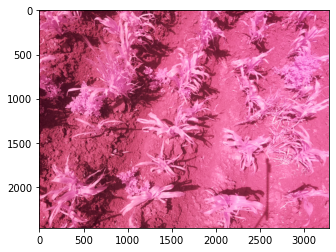

Running inference for imagen2.jpg... Done


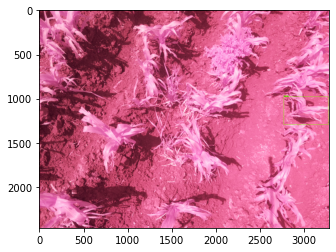

Running inference for imagen3.jpg... Done


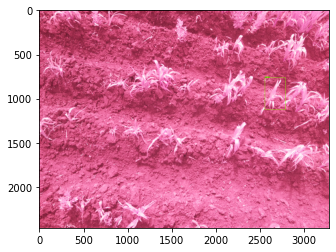

Running inference for imagen4.jpg... Done


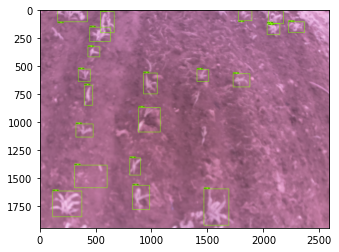

Running inference for imagen5.jpg... Done


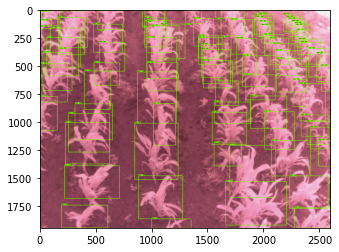

Running inference for imagen6.jpg... Done


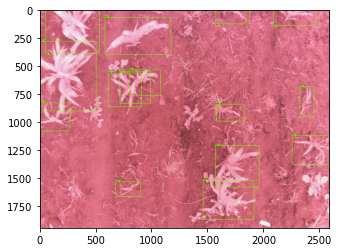

Running inference for imagen7.jpg... Done


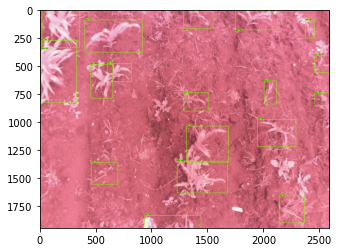

Running inference for tizon1.jpg... Done


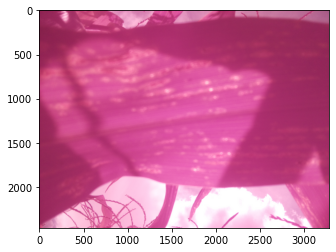

Running inference for tizon2.jpg... Done


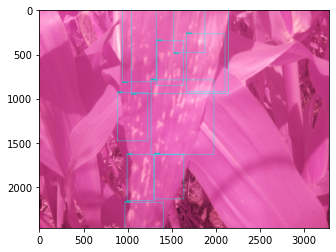

Running inference for 8img3.jpg... Done


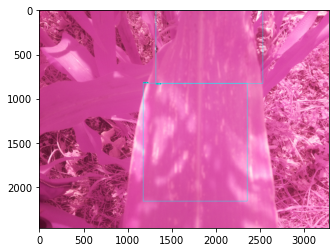

Running inference for A01.jpg... Done


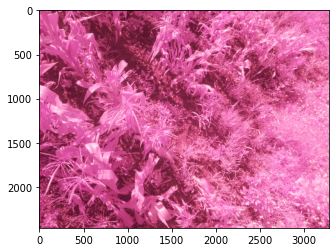

Running inference for A02.jpg... Done


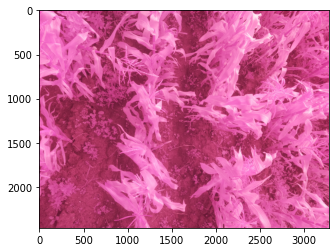

Running inference for A03.jpg... Done


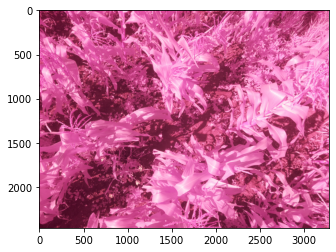

In [ ]:
#Step 20- Running the Inference.

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.

    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.

    Args:
      path: the file path to the image

    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(Image.open(path))

for image_path in img:

    print('Running inference for {}... '.format(image_path), end='')
    image_np=load_image_into_numpy_array(image_path)

    # Things to try:
    # Flip horizontally
    # image_np = np.fliplr(image_np).copy()
    # Convert image to grayscale
    # image_np = np.tile(
    #     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor=tf.convert_to_tensor(image_np)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor=input_tensor[tf.newaxis, ...]

    # input_tensor = np.expand_dims(image_np, 0)
    detections=detect_fn(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections=int(detections.pop('num_detections'))
    detections={key:value[0,:num_detections].numpy()
                   for key,value in detections.items()}
    detections['num_detections']=num_detections

    # detection_classes should be ints.
    detections['detection_classes']=detections['detection_classes'].astype(np.int64)

    image_np_with_detections=image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'],
          detections['detection_classes'],
          detections['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=100,     #max number of bounding boxes in the image
          min_score_thresh=.3,      #min prediction threshold
          agnostic_mode=False)
    %matplotlib inline
    plt.figure()
    plt.imshow(image_np_with_detections)
    print('Done')
    plt.show()

Acknowledgements:

Huge Thanks to [Lyudmil Vladimirov](http://pcwww.liv.ac.uk/~sglvladi/) for allowing me to use some of the content from their amazing [TensorFlow 2 Object Detection API](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/index.html) for Local Machines!

Link to their [GitHub Repository](https://github.com/sglvladi/TensorFlowObjectDetectionTutorial).